In [1]:
import numpy as np
import pandas as pd
import matplotlib as plt
import seaborn as sns
%matplotlib inline
pd.set_option('display.max_rows',None)

In [2]:
calls = pd.read_csv('911.csv')

In [3]:
calls.head()

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
0,40.297876,-75.581294,REINDEER CT & DEAD END; NEW HANOVER; Station ...,19525.0,EMS: BACK PAINS/INJURY,2015-12-10 17:40:00,NEW HANOVER,REINDEER CT & DEAD END,1
1,40.258061,-75.264680,BRIAR PATH & WHITEMARSH LN; HATFIELD TOWNSHIP...,19446.0,EMS: DIABETIC EMERGENCY,2015-12-10 17:40:00,HATFIELD TOWNSHIP,BRIAR PATH & WHITEMARSH LN,1
2,40.121182,-75.351975,HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...,19401.0,Fire: GAS-ODOR/LEAK,2015-12-10 17:40:00,NORRISTOWN,HAWS AVE,1
3,40.116153,-75.343513,AIRY ST & SWEDE ST; NORRISTOWN; Station 308A;...,19401.0,EMS: CARDIAC EMERGENCY,2015-12-10 17:40:01,NORRISTOWN,AIRY ST & SWEDE ST,1
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 17:40:01,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1


In [4]:
print('There are 99492 calls')

There are 99492 calls


In [5]:
print('How many types of incidents are there?')

How many types of incidents are there?


In [6]:
len(calls['title'].value_counts())

110

In [7]:
print('How many calls were recieved for each incidents')

How many calls were recieved for each incidents


In [8]:
calls['title'].value_counts()

Traffic: VEHICLE ACCIDENT -             23066
Traffic: DISABLED VEHICLE -              7702
Fire: FIRE ALARM                         5496
EMS: RESPIRATORY EMERGENCY               5112
EMS: CARDIAC EMERGENCY                   5012
EMS: FALL VICTIM                         4863
EMS: VEHICLE ACCIDENT                    3935
Traffic: ROAD OBSTRUCTION -              3144
EMS: SUBJECT IN PAIN                     2687
EMS: HEAD INJURY                         2631
EMS: UNKNOWN MEDICAL EMERGENCY           1873
EMS: SYNCOPAL EPISODE                    1717
Fire: VEHICLE ACCIDENT                   1638
EMS: SEIZURES                            1630
EMS: GENERAL WEAKNESS                    1464
Fire: FIRE INVESTIGATION                 1460
EMS: ABDOMINAL PAINS                     1436
EMS: ALTERED MENTAL STATUS               1386
EMS: MEDICAL ALERT ALARM                 1342
EMS: HEMORRHAGING                        1259
EMS: CVA/STROKE                          1202
EMS: OVERDOSE                     

In [9]:
calls.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99492 entries, 0 to 99491
Data columns (total 9 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   lat        99492 non-null  float64
 1   lng        99492 non-null  float64
 2   desc       99492 non-null  object 
 3   zip        86637 non-null  float64
 4   title      99492 non-null  object 
 5   timeStamp  99492 non-null  object 
 6   twp        99449 non-null  object 
 7   addr       98973 non-null  object 
 8   e          99492 non-null  int64  
dtypes: float64(3), int64(1), object(5)
memory usage: 6.8+ MB


In [10]:
print('There were 99492 calls with: 99492 lat provided, 99492 lng provided, 99492 desc provided, 86637 zip codes provided, '
     '99492 incidents, 99492 timeStamp, 99449 twp, 98973 addresses provided and 99492 e.')

There were 99492 calls with: 99492 lat provided, 99492 lng provided, 99492 desc provided, 86637 zip codes provided, 99492 incidents, 99492 timeStamp, 99449 twp, 98973 addresses provided and 99492 e.


In [11]:
print('List the people that provided their addresses but did no provide zip code?')

List the people that provided their addresses but did no provide zip code?


In [12]:
calls[(calls['addr'].notnull()) & (calls['zip'].isnull())]

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
4,40.251492,-75.603350,CHERRYWOOD CT & DEAD END; LOWER POTTSGROVE; S...,NaN,EMS: DIZZINESS,2015-12-10 17:40:01,LOWER POTTSGROVE,CHERRYWOOD CT & DEAD END,1
10,40.231990,-75.251891,RT202 PKWY & KNAPP RD; MONTGOMERY; 2015-12-10 ...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-10 17:40:01,MONTGOMERY,RT202 PKWY & KNAPP RD,1
14,40.097222,-75.376195,SCHUYLKILL EXPY & CROTON RD UNDERPASS; UPPER M...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-10 17:40:02,UPPER MERION,SCHUYLKILL EXPY & CROTON RD UNDERPASS,1
23,40.143326,-75.422819,RT422 & PAWLINGS RD OVERPASS; LOWER PROVIDENC...,NaN,Traffic: DISABLED VEHICLE -,2015-12-10 18:02:02,LOWER PROVIDENCE,RT422 & PAWLINGS RD OVERPASS,1
24,40.153268,-75.189558,SUMMIT AVE & RT309 UNDERPASS; UPPER DUBLIN; 20...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-10 18:02:02,UPPER DUBLIN,SUMMIT AVE & RT309 UNDERPASS,1
28,40.097222,-75.376195,SCHUYLKILL EXPY & WEADLEY RD OVERPASS; UPPER M...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-10 18:06:26,UPPER MERION,SCHUYLKILL EXPY & WEADLEY RD OVERPASS,1
30,40.097222,-75.376195,SCHUYLKILL EXPY & WEADLEY RD OVERPASS; UPPER M...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-10 18:11:01,UPPER MERION,SCHUYLKILL EXPY & WEADLEY RD OVERPASS,1
36,40.221227,-75.288737,MORRIS RD & MUHLENBURG DR; UPPER GWYNEDD; 2015...,NaN,Traffic: DISABLED VEHICLE -,2015-12-10 18:27:01,UPPER GWYNEDD,MORRIS RD & MUHLENBURG DR,1
39,40.066718,-75.307176,CONSHOHOCKEN STATE RD; WEST CONSHOHOCKEN; Sta...,NaN,EMS: VEHICLE ACCIDENT,2015-12-10 18:32:02,WEST CONSHOHOCKEN,CONSHOHOCKEN STATE RD,1
44,40.024967,-75.282905,ROSEMONT AVE & DEAD END; LOWER MERION; Statio...,NaN,EMS: CARDIAC EMERGENCY,2015-12-10 18:47:01,LOWER MERION,ROSEMONT AVE & DEAD END,1


In [13]:
print('How many people provided their addresses but did no provide zip?')

How many people provided their addresses but did no provide zip?


In [14]:
print('They are:', len(calls[(calls['addr'].notnull()) & (calls['zip'].isnull())]))

They are: 12383


In [15]:
print('What is the address of caller 459?')

What is the address of caller 459?


In [16]:
print('Address of caller 459:', calls.loc[459, 'addr'])

Address of caller 459: PENLLYN PIKE & FOXFIELD RD


In [17]:
calls['addr']

0                                   REINDEER CT & DEAD END
1                               BRIAR PATH & WHITEMARSH LN
2                                                 HAWS AVE
3                                       AIRY ST & SWEDE ST
4                                 CHERRYWOOD CT & DEAD END
5                                    CANNON AVE & W 9TH ST
6                                 LAUREL AVE & OAKDALE AVE
7                             COLLEGEVILLE RD & LYWISKI RD
8                            MAIN ST & OLD SUMNEYTOWN PIKE
9                 BLUEROUTE  & RAMP I476 NB TO CHEMICAL RD
10                                   RT202 PKWY & KNAPP RD
11                                   BROOK RD & COLWELL LN
12                           BYBERRY AVE & S WARMINSTER RD
13                                 OLD YORK RD & VALLEY RD
14                   SCHUYLKILL EXPY & CROTON RD UNDERPASS
15                                 STUMP RD & WITCHWOOD DR
16                             SUSQUEHANNA AVE & W MAIN 

In [18]:
print('What description was provided from caller 9000')

What description was provided from caller 9000


In [19]:
print('Description of caller 9000:', calls.loc[9000, 'desc'])

Description of caller 9000: MAIN ST & KULP RD;  LOWER SALFORD; Station 344; 2016-01-04 @ 10:29:25;


In [20]:
calls['desc']

0        REINDEER CT & DEAD END;  NEW HANOVER; Station ...
1        BRIAR PATH & WHITEMARSH LN;  HATFIELD TOWNSHIP...
2        HAWS AVE; NORRISTOWN; 2015-12-10 @ 14:39:21-St...
3        AIRY ST & SWEDE ST;  NORRISTOWN; Station 308A;...
4        CHERRYWOOD CT & DEAD END;  LOWER POTTSGROVE; S...
5        CANNON AVE & W 9TH ST;  LANSDALE; Station 345;...
6        LAUREL AVE & OAKDALE AVE;  HORSHAM; Station 35...
7        COLLEGEVILLE RD & LYWISKI RD;  SKIPPACK; Stati...
8        MAIN ST & OLD SUMNEYTOWN PIKE;  LOWER SALFORD;...
9        BLUEROUTE  & RAMP I476 NB TO CHEMICAL RD; PLYM...
10       RT202 PKWY & KNAPP RD; MONTGOMERY; 2015-12-10 ...
11       BROOK RD & COLWELL LN; PLYMOUTH; 2015-12-10 @ ...
12       BYBERRY AVE & S WARMINSTER RD; UPPER MORELAND;...
13       OLD YORK RD & VALLEY RD; CHELTENHAM; 2015-12-1...
14       SCHUYLKILL EXPY & CROTON RD UNDERPASS; UPPER M...
15       STUMP RD & WITCHWOOD DR; MONTGOMERY; 2015-12-1...
16       SUSQUEHANNA AVE & W MAIN ST;  LANSDALE; Statio.

In [21]:
print('List the callers that called from CHESTER COUNTY')

List the callers that called from CHESTER COUNTY


In [22]:
calls[calls['twp']=='CHESTER COUNTY']

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
79,40.231511,-75.654560,HANOVER ST & E URNER ST; CHESTER COUNTY; Stat...,19465.0,EMS: FALL VICTIM,2015-12-10 20:31:01,CHESTER COUNTY,HANOVER ST & E URNER ST,1
84,40.230455,-75.633982,WORTH BLVD & TYSON ST; CHESTER COUNTY; Statio...,19465.0,EMS: MEDICAL ALERT ALARM,2015-12-10 20:52:02,CHESTER COUNTY,WORTH BLVD & TYSON ST,1
276,40.229026,-75.637485,KEIM ST & W MEADOWBROOK RD; CHESTER COUNTY; S...,19465.0,EMS: FALL VICTIM,2015-12-11 13:27:01,CHESTER COUNTY,KEIM ST & W MEADOWBROOK RD,1
289,40.229008,-75.387852,SCHUYLKILL RD & RAMP RT724 TO RT100 SB; CHESTE...,NaN,Traffic: VEHICLE LEAKING FUEL -,2015-12-11 14:02:02,CHESTER COUNTY,SCHUYLKILL RD & RAMP RT724 TO RT100 SB,1
386,40.229008,-75.387852,RT422 BYP WB & RT100 UNDERPASS; CHESTER COUNTY...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-11 17:31:01,CHESTER COUNTY,RT422 BYP WB & RT100 UNDERPASS,1
400,40.229008,-75.387852,RT422 BYP WB & RAMP RT100 SB TO RT422 WB; CHES...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-11 17:52:02,CHESTER COUNTY,RT422 BYP WB & RAMP RT100 SB TO RT422 WB,1
402,40.229008,-75.387852,RT422 BYP WB; CHESTER COUNTY; Station 3A84; 2...,NaN,EMS: VEHICLE ACCIDENT,2015-12-11 18:01:00,CHESTER COUNTY,RT422 BYP WB,1
407,40.229008,-75.387852,RT422 BYP & RAMP RT422 WB TO RT100 NB; CHESTE...,NaN,EMS: VEHICLE ACCIDENT,2015-12-11 18:02:02,CHESTER COUNTY,RT422 BYP & RAMP RT422 WB TO RT100 NB,1
408,40.229008,-75.387852,RT422 BYP & RAMP RT422 WB TO RT100 NB; CHESTER...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-11 18:02:02,CHESTER COUNTY,RT422 BYP & RAMP RT422 WB TO RT100 NB,1
762,40.229008,-75.387852,S HANOVER ST & E HOFFECKER RD; CHESTER COUNTY;...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-12 17:27:01,CHESTER COUNTY,S HANOVER ST & E HOFFECKER RD,1


In [23]:
print('How many are they?')

How many are they?


In [24]:
print('They are:', len(calls[calls['twp']=='CHESTER COUNTY']))

They are: 1139


In [25]:
print('List the callers that called from CHESTER COUNTY that also provided their zip codes')

List the callers that called from CHESTER COUNTY that also provided their zip codes


In [26]:
calls[(calls['twp']=='CHESTER COUNTY') & (calls['zip'].notnull())]

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
79,40.231511,-75.654560,HANOVER ST & E URNER ST; CHESTER COUNTY; Stat...,19465.0,EMS: FALL VICTIM,2015-12-10 20:31:01,CHESTER COUNTY,HANOVER ST & E URNER ST,1
84,40.230455,-75.633982,WORTH BLVD & TYSON ST; CHESTER COUNTY; Statio...,19465.0,EMS: MEDICAL ALERT ALARM,2015-12-10 20:52:02,CHESTER COUNTY,WORTH BLVD & TYSON ST,1
276,40.229026,-75.637485,KEIM ST & W MEADOWBROOK RD; CHESTER COUNTY; S...,19465.0,EMS: FALL VICTIM,2015-12-11 13:27:01,CHESTER COUNTY,KEIM ST & W MEADOWBROOK RD,1
830,40.211510,-75.625910,SCHOOLHOUSE RD & EARL DR; CHESTER COUNTY; Sta...,19465.0,EMS: FALL VICTIM,2015-12-12 19:47:01,CHESTER COUNTY,SCHOOLHOUSE RD & EARL DR,1
919,40.232445,-75.710780,HONEYSUCKLE LN & UNIONVILLE RD; CHESTER COUNT...,19465.0,EMS: GENERAL WEAKNESS,2015-12-13 00:27:01,CHESTER COUNTY,HONEYSUCKLE LN & UNIONVILLE RD,1
1259,40.235271,-75.701225,SHEFFIELD LN & SHENKEL RD; CHESTER COUNTY; St...,19465.0,EMS: CVA/STROKE,2015-12-14 04:47:00,CHESTER COUNTY,SHEFFIELD LN & SHENKEL RD,1
1378,40.233415,-75.654021,HANOVER ST & E SCHUYLKILL RD; CHESTER COUNTY;...,19465.0,EMS: CARDIAC EMERGENCY,2015-12-14 11:12:01,CHESTER COUNTY,HANOVER ST & E SCHUYLKILL RD,1
1706,40.208635,-75.652179,KEIM ST & BICKEL RD; CHESTER COUNTY; Station ...,19465.0,EMS: BUILDING FIRE,2015-12-15 04:31:01,CHESTER COUNTY,KEIM ST & BICKEL RD,1
1875,40.235467,-75.684980,CATFISH LN & W SCHUYLKILL RD; CHESTER COUNTY; ...,19465.0,Traffic: ROAD OBSTRUCTION -,2015-12-15 13:02:04,CHESTER COUNTY,CATFISH LN & W SCHUYLKILL RD,1
2187,40.194591,-75.616086,ELLIS WOODS RD & HERSHEY DR; CHESTER COUNTY; ...,19465.0,EMS: UNRESPONSIVE SUBJECT,2015-12-16 08:52:00,CHESTER COUNTY,ELLIS WOODS RD & HERSHEY DR,1


In [27]:
print('How many are they?')

How many are they?


In [28]:
print('They are: ',len(calls[(calls['twp']=='CHESTER COUNTY') & (calls['zip'].notnull())]))

They are:  564


In [29]:
print('List the callers from CHESTER COUNTY that did not provide their zip codes')

List the callers from CHESTER COUNTY that did not provide their zip codes


In [30]:
calls[(calls['twp']=='CHESTER COUNTY') & (calls['zip'].isnull())]

,lat,lng,desc,zip,title,timeStamp,twp,addr,e
289,40.229008,-75.387852,SCHUYLKILL RD & RAMP RT724 TO RT100 SB; CHESTE...,NaN,Traffic: VEHICLE LEAKING FUEL -,2015-12-11 14:02:02,CHESTER COUNTY,SCHUYLKILL RD & RAMP RT724 TO RT100 SB,1
386,40.229008,-75.387852,RT422 BYP WB & RT100 UNDERPASS; CHESTER COUNTY...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-11 17:31:01,CHESTER COUNTY,RT422 BYP WB & RT100 UNDERPASS,1
400,40.229008,-75.387852,RT422 BYP WB & RAMP RT100 SB TO RT422 WB; CHES...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-11 17:52:02,CHESTER COUNTY,RT422 BYP WB & RAMP RT100 SB TO RT422 WB,1
402,40.229008,-75.387852,RT422 BYP WB; CHESTER COUNTY; Station 3A84; 2...,NaN,EMS: VEHICLE ACCIDENT,2015-12-11 18:01:00,CHESTER COUNTY,RT422 BYP WB,1
407,40.229008,-75.387852,RT422 BYP & RAMP RT422 WB TO RT100 NB; CHESTE...,NaN,EMS: VEHICLE ACCIDENT,2015-12-11 18:02:02,CHESTER COUNTY,RT422 BYP & RAMP RT422 WB TO RT100 NB,1
408,40.229008,-75.387852,RT422 BYP & RAMP RT422 WB TO RT100 NB; CHESTER...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-11 18:02:02,CHESTER COUNTY,RT422 BYP & RAMP RT422 WB TO RT100 NB,1
762,40.229008,-75.387852,S HANOVER ST & E HOFFECKER RD; CHESTER COUNTY;...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-12 17:27:01,CHESTER COUNTY,S HANOVER ST & E HOFFECKER RD,1
763,40.229008,-75.387852,HANOVER ST & TEMPLE RD; CHESTER COUNTY; 2015-1...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-12 17:32:01,CHESTER COUNTY,HANOVER ST & TEMPLE RD,1
1067,40.229008,-75.387852,SCHUYLKILL RD & RAMP RT724 TO RT100 SB; CHESTE...,NaN,Traffic: VEHICLE ACCIDENT -,2015-12-13 13:52:02,CHESTER COUNTY,SCHUYLKILL RD & RAMP RT724 TO RT100 SB,1
1684,40.229008,-75.387852,NO LOCATION - NEIGHBORING COUNTY; CHESTER COU...,NaN,EMS: RESPIRATORY EMERGENCY,2015-12-15 01:12:02,CHESTER COUNTY,NO LOCATION - NEIGHBORING COUNTY,1


In [31]:
print('How many are they?')

How many are they?


In [32]:
print('They are:' ,len(calls[(calls['twp']=='CHESTER COUNTY') & (calls['zip'].isnull())]))

They are: 575


In [34]:
print('What is the average number calls received for all incidents?')

What is the average number calls received for all incidents?


In [33]:
x = calls['title'].value_counts()
x.mean()

904.4727272727273

<Axes: xlabel='title', ylabel='Count'>

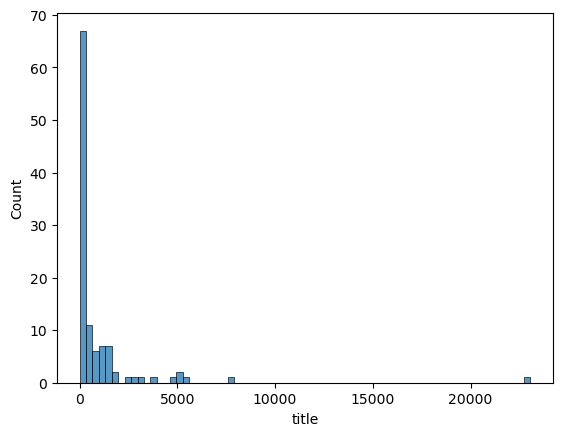

In [49]:
sns.histplot(calls['title'].value_counts())

<Axes: xlabel='title', ylabel='Density'>

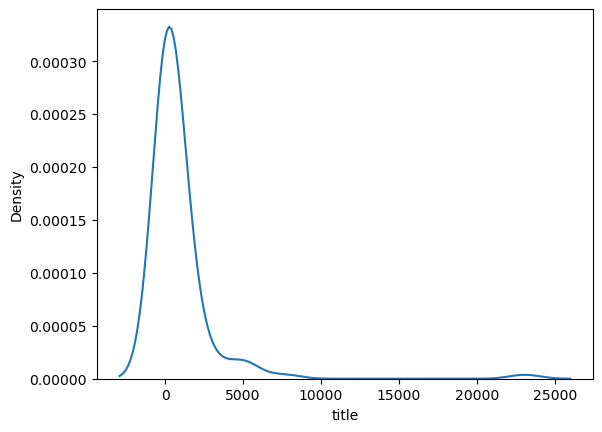

In [57]:
sns.kdeplot(calls['title'].value_counts())